In [6]:
# my github repo address
repo_url = 'https://github.com/ElifSeven/object_detection_demo'

# Number of training steps.
num_steps = 5000  # it can be change

# Number of evaluation steps.
num_eval_steps = 50

MODELS_CONFIG = {
    'ssd_mobilenet_v2': {
        'model_name': 'ssd_mobilenet_v2_coco_2018_03_29',
        'pipeline_file': 'ssd_mobilenet_v2_coco.config',
        'batch_size': 12
    },
    'faster_rcnn_inception_v2': {
        'model_name': 'faster_rcnn_inception_v2_coco_2018_01_28',
        'pipeline_file': 'faster_rcnn_inception_v2_pets.config',
        'batch_size': 12
    },
    'rfcn_resnet101': {
        'model_name': 'rfcn_resnet101_coco_2018_01_28',
        'pipeline_file': 'rfcn_resnet101_pets.config',
        'batch_size': 8
    }
}

# Pick the model you want to use
# Select a model in `MODELS_CONFIG`.
selected_model = 'ssd_mobilenet_v2'

# Name of the object detection model to use.
MODEL = MODELS_CONFIG[selected_model]['model_name']

# Name of the pipline file in tensorflow object detection API.
pipeline_file = MODELS_CONFIG[selected_model]['pipeline_file']

# Training batch size fits in Colabe's Tesla K80 GPU memory for selected model.
batch_size = MODELS_CONFIG[selected_model]['batch_size']

**Clone the object_detection_demo my repository**

In [7]:
import os

%cd /content/gdrive/MyDrive/SSD-tensorflow

repo_dir_path = os.path.abspath(os.path.join('.', os.path.basename(repo_url)))

!git clone {repo_url}
%cd {repo_dir_path}
!git pull

/content/gdrive/MyDrive/SSD-tensorflow
fatal: destination path 'object_detection_demo' already exists and is not an empty directory.
/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo
fatal: not a git repository (or any parent up to mount point /content)
Stopping at filesystem boundary (GIT_DISCOVERY_ACROSS_FILESYSTEM not set).


**Connect to Google drive**

In [3]:
# Connecting to Google Drive to access folders

%cd ..
from google.colab import drive
drive.mount('/content/gdrive')

/
Mounted at /content/gdrive


In [4]:
# I change My\ Drive/ to mydrive for easier

!ln -s /content/gdrive/My\ Drive/ /mydrive

In [5]:
# I am controlling the contents of I created yolov folder

!ls /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo

data			    README.md
deploy			    requirements.txt
generate_tfrecord.py	    resize_images.py
LICENSE			    tensorflow_object_detection_training_colab.ipynb
local_inference_test.ipynb  test
local_inference_test.py     xml_to_csv.py


In [8]:
# If library errors occur, executable

# !pip install tf-models-official


     |████████████████████████████████| 1.1MB 8.3MB/s 
     |████████████████████████████████| 358kB 31.0MB/s 
     |████████████████████████████████| 51kB 7.9MB/s 
     |████████████████████████████████| 37.6MB 78kB/s 
     |████████████████████████████████| 706kB 57.5MB/s 
     |████████████████████████████████| 1.2MB 55.6MB/s 
     |████████████████████████████████| 174kB 53.1MB/s 
     |████████████████████████████████| 102kB 13.4MB/s 
     |████████████████████████████████| 645kB 50.2MB/s 
  Created wheel for seqeval: filename=seqeval-1.2.2-cp37-none-any.whl size=16172 sha256=6da5085dbd5e7934d78a286b9f34de5e3482b5fb7701ce43e9548eb85a2b2a76
  Stored in directory: /root/.cache/pip/wheels/52/df/1b/45d75646c37428f7e626214704a0e35bd3cfc32eda37e59e5f
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-cp37-none-any.whl size=22245 sha256=4b02ff7ad2ef2437c3c44f0b67aeebdf427bcc97fb48c91e535aa168bd30cee5
  Stored in directory: /root/.cache/pip/wheels/2e/15/f5/aa2a056d223903b52cf487013

**Install required packages from tensorflow link**

In [9]:
%cd /content/gdrive/MyDrive/SSD-tensorflow
!git clone --quiet https://github.com/tensorflow/models.git

!apt-get install -qq protobuf-compiler python-pil python-lxml python-tk

!pip install -q Cython contextlib2 pillow lxml matplotlib

!pip install -q pycocotools

!pip install tf_slim

%cd /content/gdrive/MyDrive/SSD-tensorflow/models/research
!protoc object_detection/protos/*.proto --python_out=.

import os
os.environ['PYTHONPATH'] += '://content/gdrive/MyDrive/SSD-tensorflow/models/research/://content/gdrive/MyDrive/SSD-tensorflow/models/research/slim/'

!python /content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection/builders/model_builder_test.py

/content/gdrive/MyDrive/SSD-tensorflow
fatal: destination path 'models' already exists and is not an empty directory.
Selecting previously unselected package python-bs4.
(Reading database ... 160690 files and directories currently installed.)
Preparing to unpack .../0-python-bs4_4.6.0-1_all.deb ...
Unpacking python-bs4 (4.6.0-1) ...
Selecting previously unselected package python-pkg-resources.
Preparing to unpack .../1-python-pkg-resources_39.0.1-2_all.deb ...
Unpacking python-pkg-resources (39.0.1-2) ...
Selecting previously unselected package python-chardet.
Preparing to unpack .../2-python-chardet_3.0.4-1_all.deb ...
Unpacking python-chardet (3.0.4-1) ...
Selecting previously unselected package python-six.
Preparing to unpack .../3-python-six_1.11.0-2_all.deb ...
Unpacking python-six (1.11.0-2) ...
Selecting previously unselected package python-webencodings.
Preparing to unpack .../4-python-webencodings_0.5-2_all.deb ...
Unpacking python-webencodings (0.5-2) ...
Selecting previously

**Prepare tfrecord files**

In [ ]:
# Convert train folder annotation xml files to a single csv file,
# generate the `label_map.pbtxt` file to `data/` directory as well.
#python xml_to_csv.py -i data/images/train -o data/annotations/train_labels.csv -l data/annotations
 
# Convert test folder annotation xml files to a single csv.
#python xml_to_csv.py -i data/images/test -o data/annotations/test_labels.csv
 
# Generate `train.record`
#python generate_tfrecord.py --csv_input=data/annotations/train_labels.csv --output_path=data/annotations/train.record --img_path=data/images/train --label_map data/annotations/label_map.pbtxt
 
# Generate `test.record`
#python generate_tfrecord.py --csv_input=data/annotations/test_labels.csv --output_path=data/annotations/test.record --img_path=data/images/test --label_map data/annotations/label_map.pbtxt

**Prepare tfrecord files according my path**

In [ ]:
%cd {repo_dir_path}

# Convert train folder annotation xml files to a single csv file,
# generate the `label_map.pbtxt` file to `data/` directory as well.
!python /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/xml_to_csv.py -i /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/images/train -o /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/train_label.csv -l /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations

# Convert test folder annotation xml files to a single csv.
!python /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/xml_to_csv.py -i /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/images/test -o /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/test_label.csv 

# Generate `train.record`
!python /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/generate_tfrecord.py --csv_input=/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/train_label.csv --output_path=/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/train.record --img_path=/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/images/train --label_map /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/label_map.pbtxt

# Generate `test.record`
!python /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/generate_tfrecord.py --csv_input=/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/test_label.csv --output_path=/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/test.record --img_path=/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/images/test --label_map /content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/label_map.pbtxt

In [10]:
# if it is not working, change tensorflow version to 1x xversion

# %tensorflow_version 1.x

TensorFlow 1.x selected.


In [11]:
# If library errors(object-detection) occur, executable

# !pip install tensorflow-object-detection-api


     |████████████████████████████████| 583kB 8.8MB/s 
     |████████████████████████████████| 61kB 9.1MB/s 
     |████████████████████████████████| 51kB 7.5MB/s 
     |████████████████████████████████| 3.2MB 48.0MB/s 
  Created wheel for tensorflow-object-detection-api: filename=tensorflow_object_detection_api-0.1.1-cp37-none-any.whl size=844515 sha256=242d5271a6a8a5fb3d6e705410a2a5991e32a7978690626d669c1b2cef8e121d
  Stored in directory: /root/.cache/pip/wheels/4a/54/d0/cfca11930c4b2025d40dede77059094070a67cc3e7bd3b285f
  Created wheel for gast: filename=gast-0.2.2-cp37-none-any.whl size=7540 sha256=7287f1bed704373b5c44cba4b73960b6506207beceacb08138158d9fe9e9109b
  Stored in directory: /root/.cache/pip/wheels/5c/2e/7e/a1d4d4fcebe6c381f378ce7743a3ced3699feb89bcfbdadadd
Successfully built tensorflow-object-detection-api gast
ERROR: tf-models-official 2.4.0 has requirement tensorflow>=2.4.0, but you'll have tensorflow 1.15.2 which is incompatible.
  Found existing installation: gast 0.3

In [12]:
test_record_fname = '/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/test.record'
train_record_fname = '/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/train.record'
label_map_pbtxt_fname = '/content/gdrive/MyDrive/SSD-tensorflow/object_detection_demo/data/annotations/label_map.pbtxt'

**Download base model**

In [13]:
%cd /content/gdrive/MyDrive/SSD-tensorflow/models/research

import os
import shutil
import glob
import urllib.request
import tarfile
MODEL_FILE = MODEL + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
DEST_DIR = '/content/gdrive/MyDrive/SSD-tensorflow/models/research/pretrained_model'

if not (os.path.exists(MODEL_FILE)):
    urllib.request.urlretrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
    shutil.rmtree(DEST_DIR)
os.rename(MODEL, DEST_DIR)

/content/gdrive/MyDrive/SSD-tensorflow/models/research


In [14]:
!echo {DEST_DIR}
!ls -alh {DEST_DIR}

/content/gdrive/MyDrive/SSD-tensorflow/models/research/pretrained_model
total 135M
-rw------- 1 root root   77 Mar 30  2018 checkpoint
-rw------- 1 root root  67M Mar 30  2018 frozen_inference_graph.pb
-rw------- 1 root root  65M Mar 30  2018 model.ckpt.data-00000-of-00001
-rw------- 1 root root  15K Mar 30  2018 model.ckpt.index
-rw------- 1 root root 3.4M Mar 30  2018 model.ckpt.meta
-rw------- 1 root root 4.2K Mar 30  2018 pipeline.config
drwx------ 3 root root 4.0K Mar 30  2018 saved_model


In [15]:
fine_tune_checkpoint = os.path.join(DEST_DIR, "model.ckpt")
fine_tune_checkpoint

'/content/gdrive/MyDrive/SSD-tensorflow/models/research/pretrained_model/model.ckpt'

**Configuring a Training Pipeline**

In [16]:
import os
pipeline_fname = os.path.join('/content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection/samples/configs/', pipeline_file)

assert os.path.isfile(pipeline_fname), '`{}` not exist'.format(pipeline_fname)

In [17]:
def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())

In [18]:
import re

num_classes = get_num_classes(label_map_pbtxt_fname)
with open(pipeline_fname) as f:
    s = f.read()
with open(pipeline_fname, 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(train.record)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(val.record)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    f.write(s)

In [19]:
!cat {pipeline_fname}

# SSD with Mobilenet v2 configuration for MSCOCO Dataset.
# Users should configure the fine_tune_checkpoint field in the train config as
# well as the label_map_path and input_path fields in the train_input_reader and
# eval_input_reader. Search for "PATH_TO_BE_CONFIGURED" to find the fields that
# should be configured.

model {
  ssd {
    num_classes: 2
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6
        min_scale: 0.2
        max_scale: 0.95
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspect_

In [20]:
model_dir = '/content/gdrive/MyDrive/SSD-tensorflow/models/research/training/'
# Optionally remove content in output model directory to fresh start.
!rm -rf {model_dir}
os.makedirs(model_dir, exist_ok=True)

**Run Tensorboard(Optional)**


In [17]:
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip -o ngrok-stable-linux-amd64.zip

--2021-04-25 10:17:46--  https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
Resolving bin.equinox.io (bin.equinox.io)... 34.192.46.56, 34.196.154.11, 34.225.127.47, ...
Connecting to bin.equinox.io (bin.equinox.io)|34.192.46.56|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13828408 (13M) [application/octet-stream]
Saving to: ‘ngrok-stable-linux-amd64.zip.3’

ngrok-stable-linux- 100%[===================>]  13.19M  6.13MB/s    in 2.2s    

2021-04-25 10:17:49 (6.13 MB/s) - ‘ngrok-stable-linux-amd64.zip.3’ saved [13828408/13828408]

Archive:  ngrok-stable-linux-amd64.zip
  inflating: ngrok                   


In [18]:
LOG_DIR = model_dir
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)

In [19]:
get_ipython().system_raw('./ngrok http 6006 &')

**Get Tensorboard link**

In [20]:
! curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

https://c21a6c2c50ec.ngrok.io


**Train the model**

In [23]:
!python /content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection/model_main.py \
    --pipeline_config_path={pipeline_fname} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --num_eval_steps={num_eval_steps}

W0425 18:52:53.048436 140696276395904 model_lib.py:812] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting train_steps: 5000
I0425 18:52:53.048681 140696276395904 config_util.py:552] Maybe overwriting train_steps: 5000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0425 18:52:53.048795 140696276395904 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: 1
I0425 18:52:53.048882 140696276395904 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: 1
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0425 18:52:53.048996 140696276395904 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0425 18:52:53.049112 140696276395904 model_lib.py:828] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
INFO:tensorflow:create_estimator_and_inputs: use_tpu False, export_to_t

In [22]:
# if "lvis" library  error ocur in training, you can run this code

# !pip install lvis

In [25]:
# if "nets" library  error ocur in training, you can run this code
# !pip install nets

In [36]:
!ls {model_dir}

checkpoint
eval_0
events.out.tfevents.1619376813.79edc41fb802
export
graph.pbtxt
model.ckpt-0.data-00000-of-00001
model.ckpt-0.index
model.ckpt-0.meta
model.ckpt-2655.data-00000-of-00001
model.ckpt-2655.index
model.ckpt-2655.meta
model.ckpt-5000.data-00000-of-00001
model.ckpt-5000.index
model.ckpt-5000.meta


**It is also working**

In [28]:
# Legacy way of training

!python /content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection/legacy/train.py --logtostderr --train_dir={model_dir} --pipeline_config_path={pipeline_fname}

Streaming output truncated to the last 5000 lines.
INFO:tensorflow:global step 2514: loss = 4.5266 (0.278 sec/step)
I0424 19:38:53.011637 140501521753984 learning.py:512] global step 2514: loss = 4.5266 (0.278 sec/step)
INFO:tensorflow:global step 2515: loss = 4.8851 (0.294 sec/step)
I0424 19:38:53.306882 140501521753984 learning.py:512] global step 2515: loss = 4.8851 (0.294 sec/step)
INFO:tensorflow:global step 2516: loss = 5.9511 (0.293 sec/step)
I0424 19:38:53.601995 140501521753984 learning.py:512] global step 2516: loss = 5.9511 (0.293 sec/step)
INFO:tensorflow:global step 2517: loss = 5.2068 (0.275 sec/step)
I0424 19:38:53.883230 140501521753984 learning.py:512] global step 2517: loss = 5.2068 (0.275 sec/step)
INFO:tensorflow:global step 2518: loss = 5.1037 (0.293 sec/step)
I0424 19:38:54.179748 140501521753984 learning.py:512] global step 2518: loss = 5.1037 (0.293 sec/step)
INFO:tensorflow:global step 2519: loss = 5.0192 (0.278 sec/step)
I0424 19:38:54.463682 140501521753984 l

**Exporting a Trained Inference Graph**

Once my training job is complete, I need to extract the newly trained inference graph, which will be later used to perform the object detection.

In [37]:
import re
import numpy as np

output_directory = './fine_tuned_model'

lst = os.listdir(model_dir)
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps=np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')

last_model_path = os.path.join(model_dir, last_model)
print(last_model_path)
!python /content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path={pipeline_fname} \
    --output_directory={output_directory} \
    --trained_checkpoint_prefix={last_model_path}

/content/gdrive/MyDrive/SSD-tensorflow/models/research/training/model.ckpt-5000
Instructions for updating:
Please use `layer.__call__` method instead.
W0425 19:22:05.667808 140651576559488 deprecation.py:323] From /usr/local/lib/python3.7/dist-packages/tf_slim/layers/layers.py:1089: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
INFO:tensorflow:depth of additional conv before box predictor: 0
I0425 19:22:07.643507 140651576559488 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0425 19:22:07.679236 140651576559488 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
INFO:tensorflow:depth of additional conv before box predictor: 0
I0425 19:22:07.713139 140651576559488 convolutional_box_predictor.py:156] depth of addit

In [38]:
!ls {output_directory}

checkpoint			model.ckpt.index  saved_model
frozen_inference_graph.pb	model.ckpt.meta
model.ckpt.data-00000-of-00001	pipeline.config


**Download the model .pb file**

In [27]:
import os

pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb")
assert os.path.isfile(pb_fname), '`{}` not exist'.format(pb_fname)

In [35]:
!ls -alh {pb_fname}

ls: cannot access '/content/gdrive/My': No such file or directory
ls: cannot access 'Drive/SSD-tensorflow/models/research/fine_tuned_model/frozen_inference_graph.pb': No such file or directory


**Option1 : upload the .pb file to your Google Drive**


Then download it from your Google Drive to local file system.
During this step, you will be prompted to enter the token.

In [33]:
# Install the PyDrive wrapper & import libraries.
# This only needs to be done once in a notebook.
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials


# Authenticate and create the PyDrive client.
# This only needs to be done once in a notebook.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

fname = os.path.basename(pb_fname)
# Create & upload a text file.
uploaded = drive.CreateFile({'title': fname})
uploaded.SetContentFile(pb_fname)
uploaded.Upload()
print('Uploaded file with ID {}'.format(uploaded.get('id')))

Uploaded file with ID 1EQFDV4GRLRom_O0_j04O6yJBRmwcQZjP


**Option2 : Download the .pb file directly to your local file system**

This method may not be stable when downloading large files like the model .pb file.
Try option 1 instead if not working.

In [29]:
from google.colab import files
files.download(pb_fname)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Download the label_map.pbtxt file**

In [30]:
from google.colab import files
files.download(label_map_pbtxt_fname)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Download the modified pipline file**

In [31]:
files.download(pipeline_fname)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# !tar cfz fine_tuned_model.tar.gz fine_tuned_model
# from google.colab import files
# files.download('fine_tuned_model.tar.gz')

***Run test***

Test with images in repository test directory.

**test1** 

first part(first 20 images)

image1-image20

In [50]:
import os
import glob

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname

# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR =  os.path.join("/content/gdrive/MyDrive/SSD-tensorflow/test1")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.*"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

['/content/gdrive/MyDrive/SSD-tensorflow/test1/0.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/1.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/3.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/2.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/6.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/7.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/5.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/4.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/19.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/18.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/20.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/10.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/11.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/13.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/12.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/16.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/17.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test1/15.jpg', '/content/gdrive/

/content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection


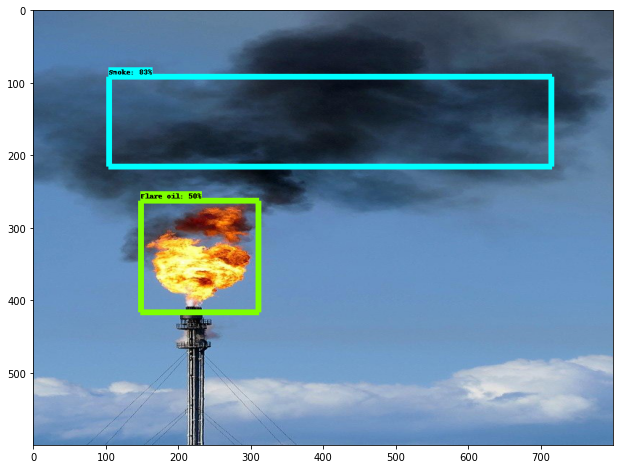

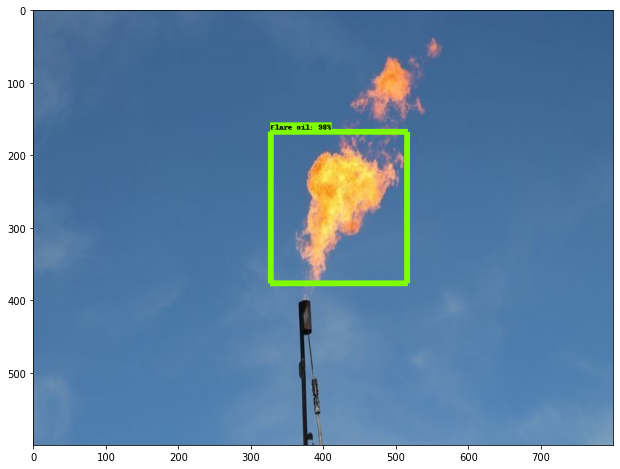

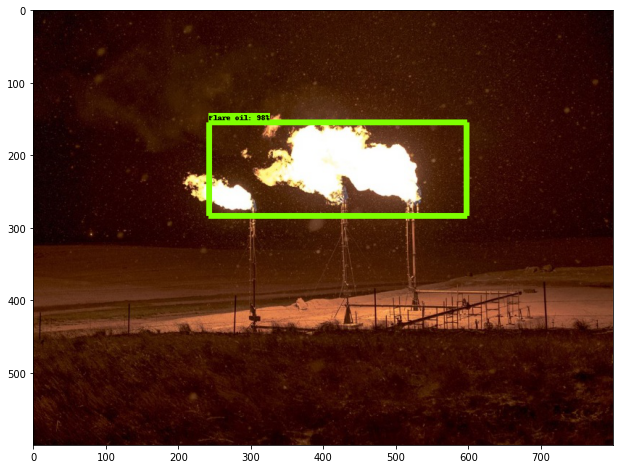

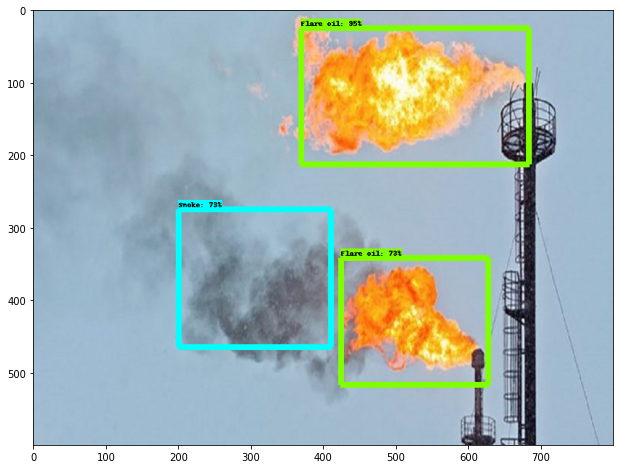

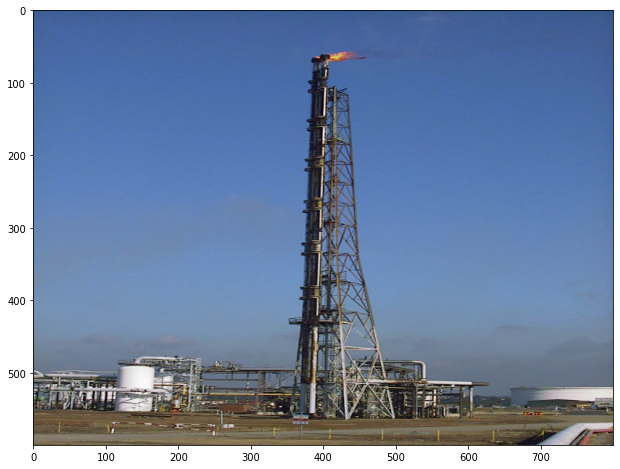

...

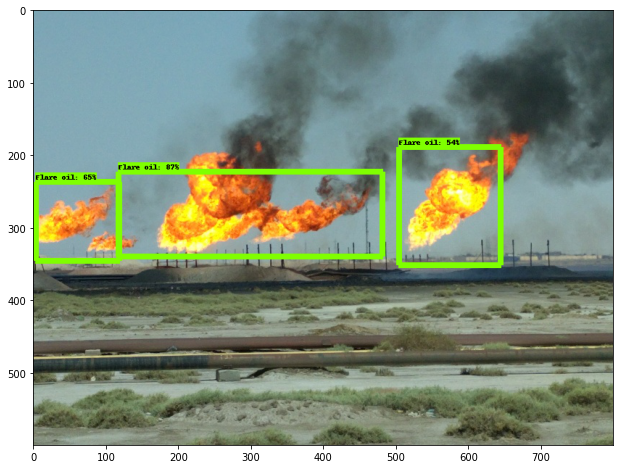

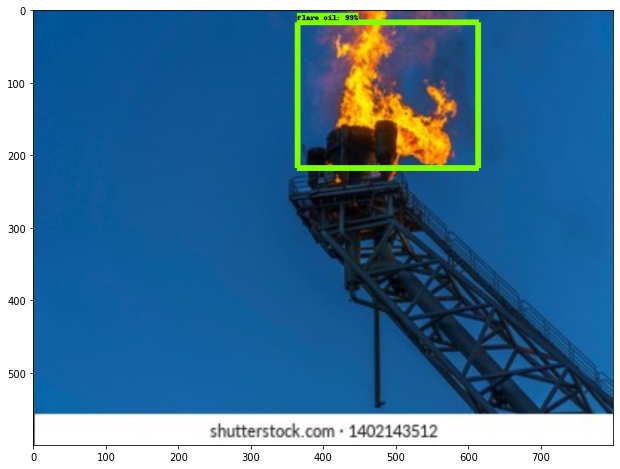

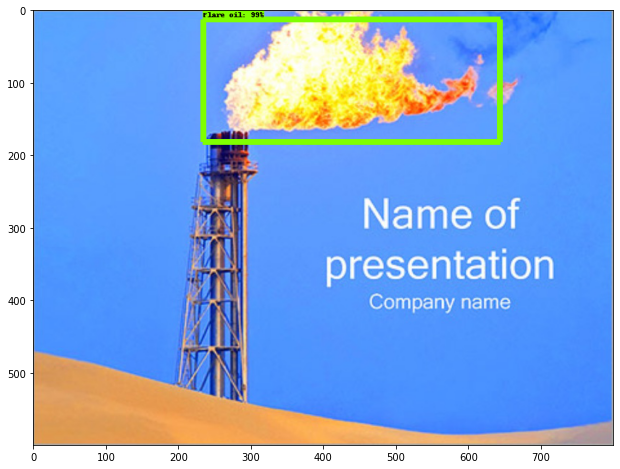

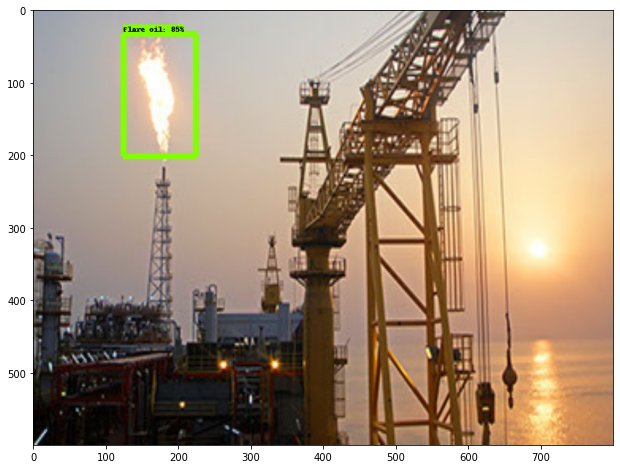

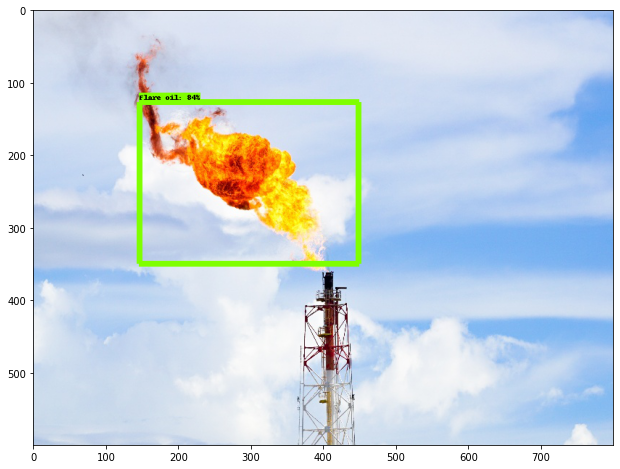

In [51]:
%cd /content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops


# This is needed to display the images.
%matplotlib inline


from object_detection.utils import label_map_util

from object_detection.utils import visualization_utils as vis_util


detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)


def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict


for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        line_thickness=8)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)

**test2** 

Second part(20 images)

In [54]:
import os
import glob

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname

# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR =  os.path.join("/content/gdrive/MyDrive/SSD-tensorflow/test2")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.*"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

['/content/gdrive/MyDrive/SSD-tensorflow/test2/30.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/25.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/32.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/31.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/40.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/24.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/26.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/27.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/33.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/23.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/21.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/34.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/22.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/35.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/38.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/36.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/39.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test2/37.jpg', '/content

/content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection


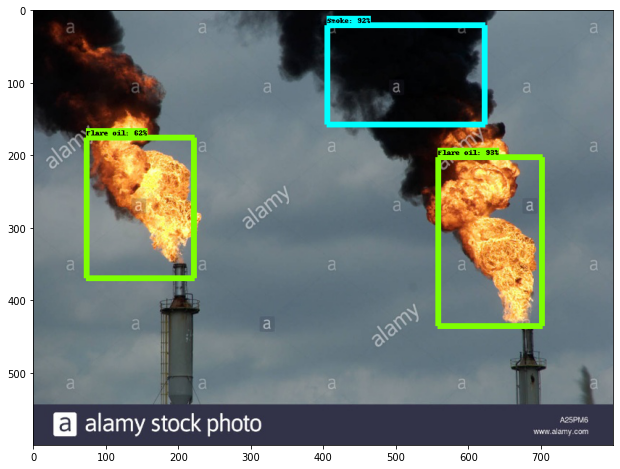

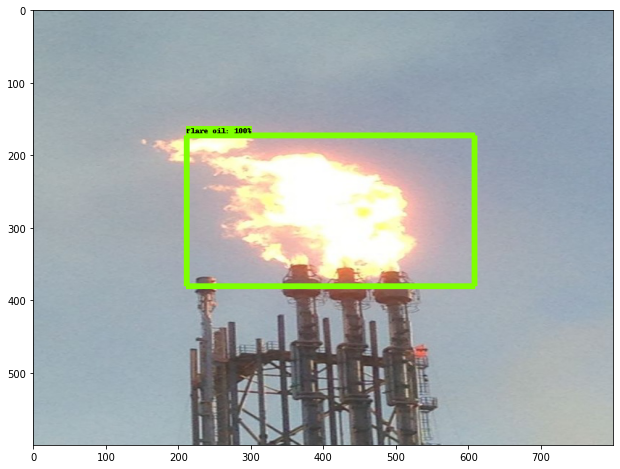

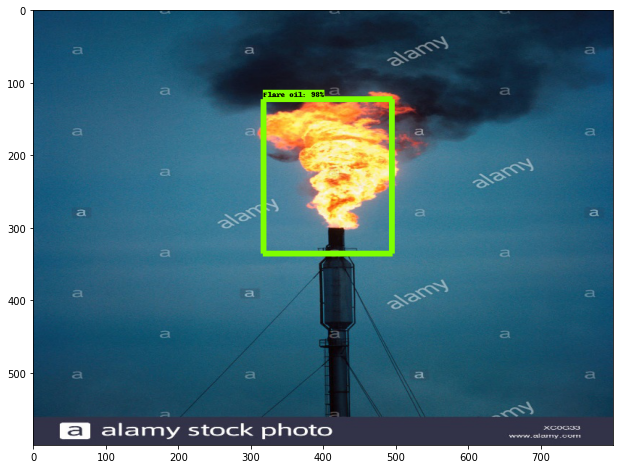

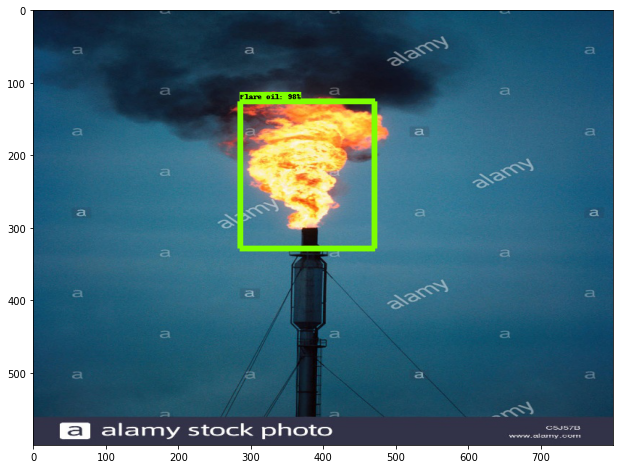

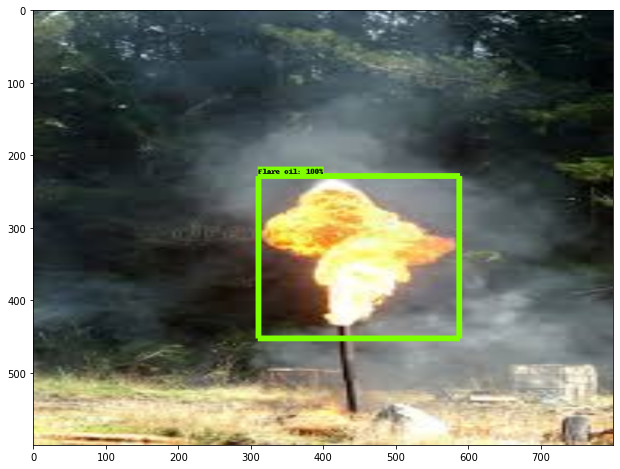

...

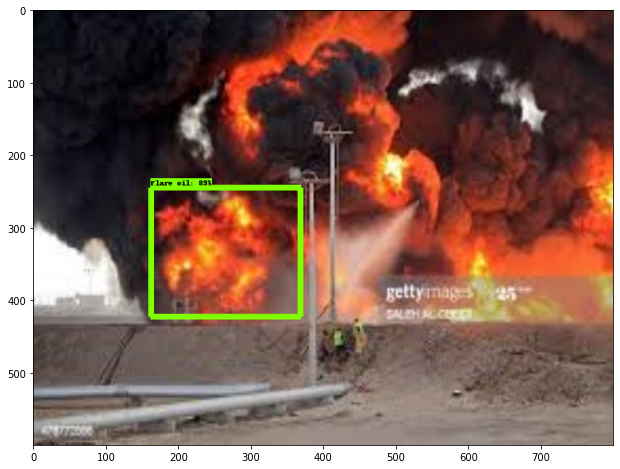

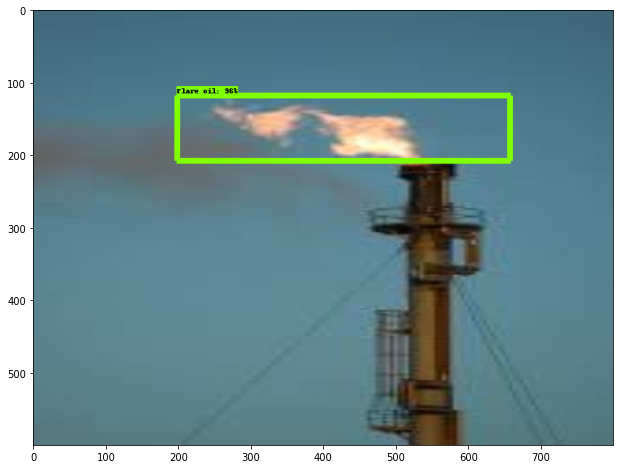

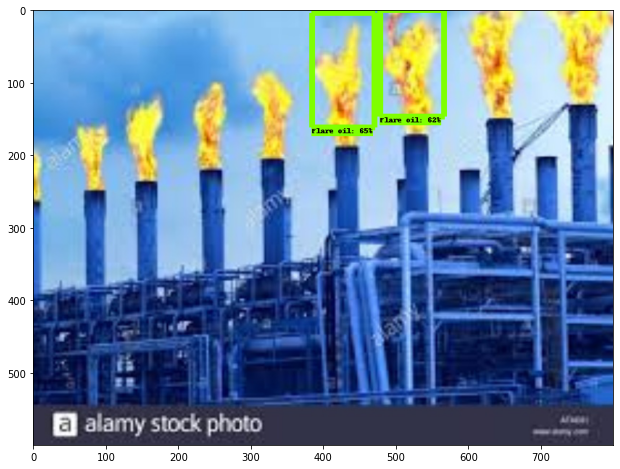

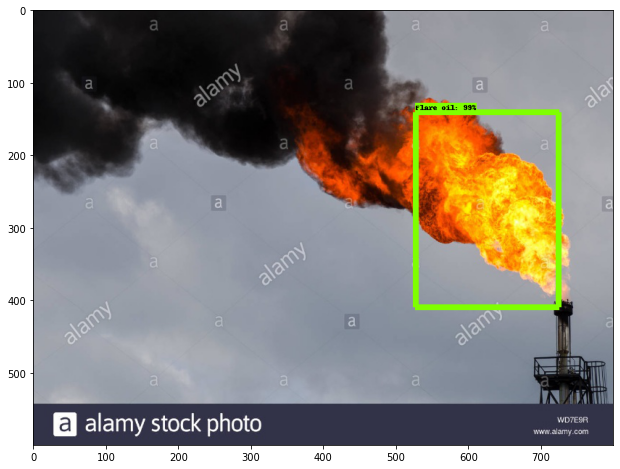

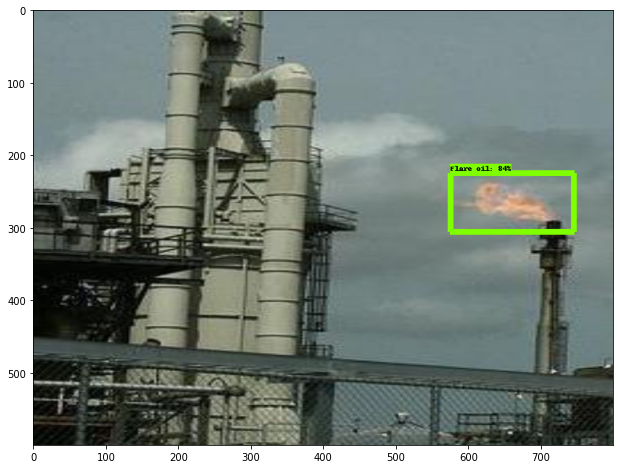

In [55]:
%cd /content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops


# This is needed to display the images.
%matplotlib inline


from object_detection.utils import label_map_util

from object_detection.utils import visualization_utils as vis_util


detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)


def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict


for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        line_thickness=8)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)

**test3**

third part

In [52]:
import os
import glob

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname

# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR =  os.path.join("/content/gdrive/MyDrive/SSD-tensorflow/test3")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.*"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

['/content/gdrive/MyDrive/SSD-tensorflow/test3/55.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/41.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/54.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/56.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/43.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/57.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/42.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/59.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/58.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/49.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/48.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/60.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/46.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/45.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/51.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/52.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/47.jpg', '/content/gdrive/MyDrive/SSD-tensorflow/test3/53.jpg', '/content

/content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection


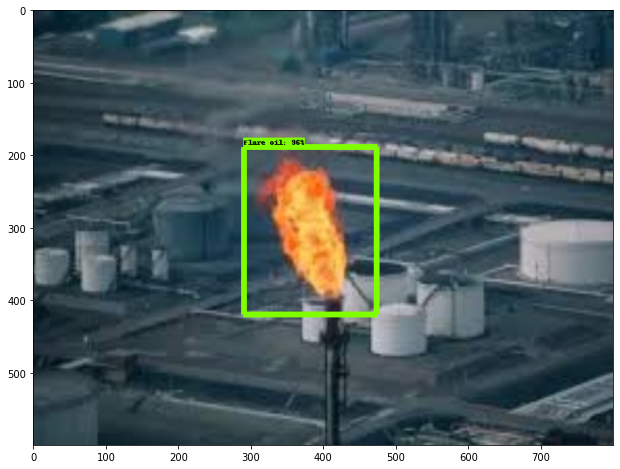

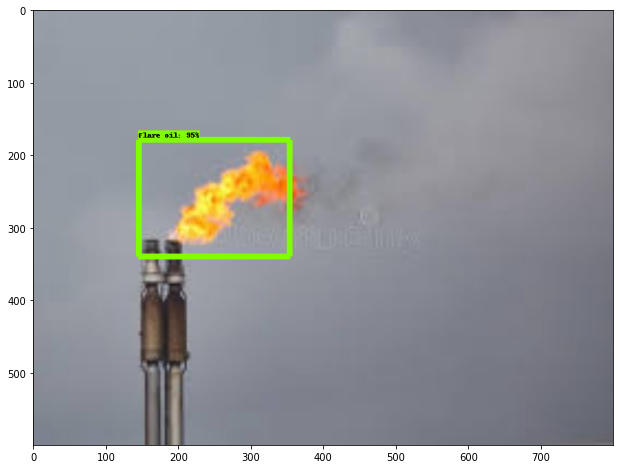

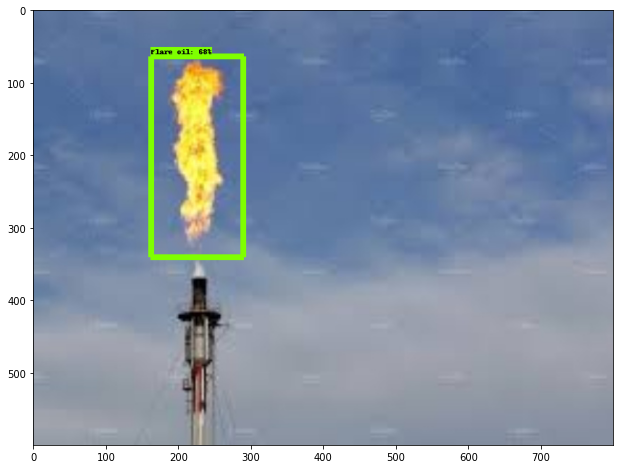

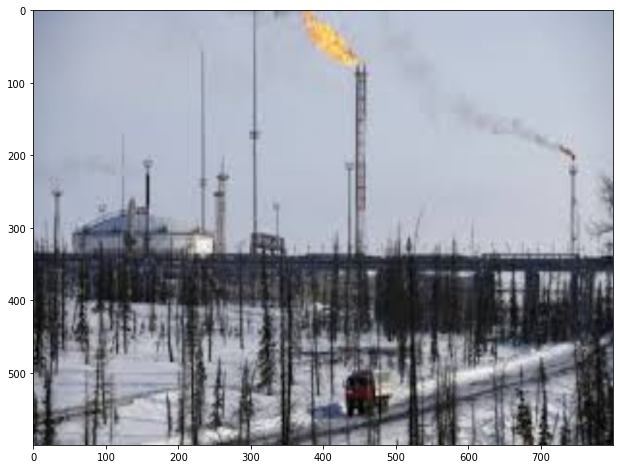

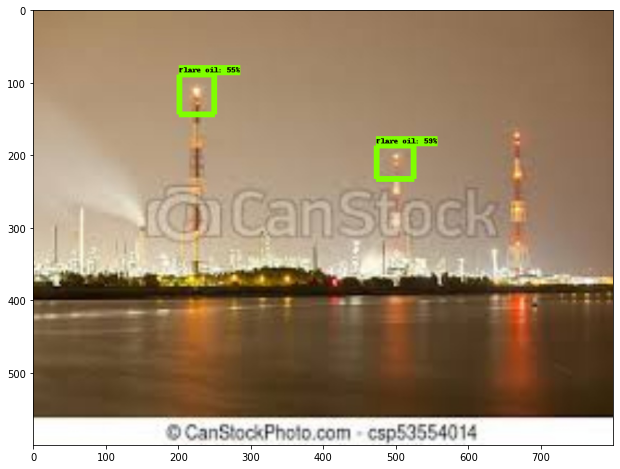

...

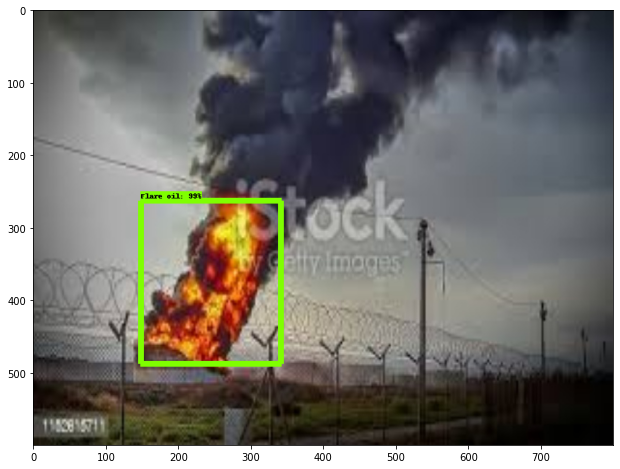

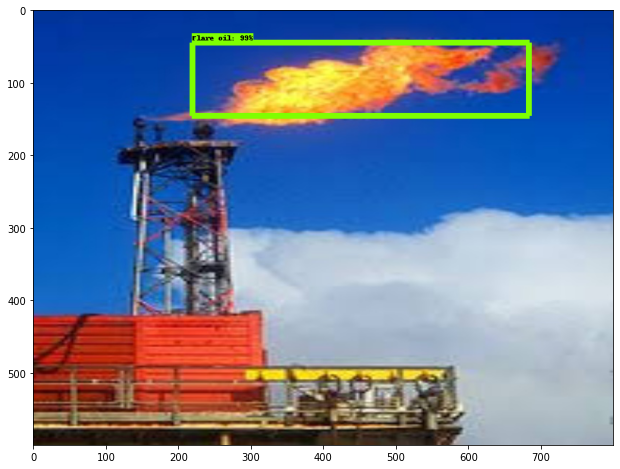

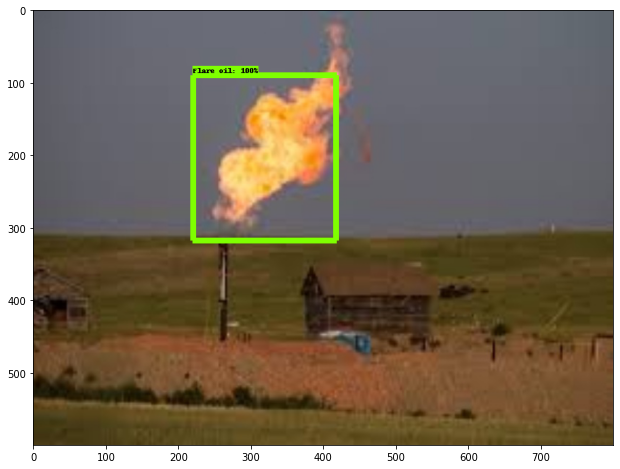

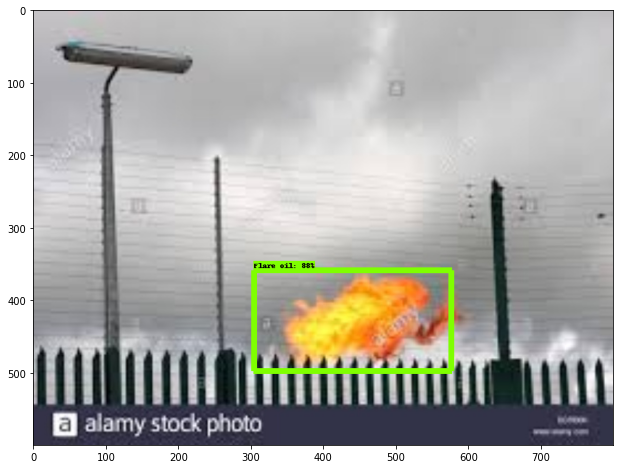

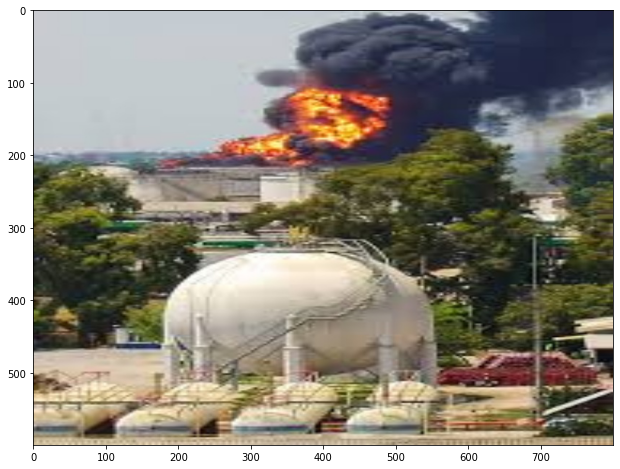

In [53]:
%cd /content/gdrive/MyDrive/SSD-tensorflow/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops


# This is needed to display the images.
%matplotlib inline


from object_detection.utils import label_map_util

from object_detection.utils import visualization_utils as vis_util


detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)


def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict


for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        line_thickness=8)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)